Exploring modern and ancient DNA data using G25 coordinates

In [1]:
require(rio)
require(tidyverse)
require(dbscan)
require(cluster)
require(factoextra)
require(cowplot)
require(gridExtra)

Loading required package: dbscan


Attaching package: ‘dbscan’


The following object is masked from ‘package:stats’:

    as.dendrogram


Loading required package: cluster

Loading required package: factoextra

Welcome! Want to learn more? See two factoextra-related books at https://goo.gl/ve3WBa

Loading required package: cowplot


Attaching package: ‘cowplot’


The following object is masked from ‘package:lubridate’:

    stamp


Loading required package: gridExtra


Attaching package: ‘gridExtra’


The following object is masked from ‘package:dplyr’:

    combine




Load the data

In [12]:
# By age / epoch for Eurasian samples
bad = as_tibble(import("../Genetics/G25/Data/CSV/Eurasia/G25_BA.csv"))
iad = as_tibble(import("../Genetics/G25/Data/CSV/Eurasia/G25_IA.csv"))
mad = as_tibble(import("../Genetics/G25/Data/CSV/Eurasia/G25_MA.csv"))
# G25 raw files for modern data
mod = as_tibble(import("../Genetics/G25/Data/CSV/Eurasia/Global25_PCA_modern_scaled.txt"))
colnames(mod) = colnames(bad)
# Averages
avgs = as_tibble(import("../Genetics/G25/Data/TXT/Global25_PCA_pop_averages_scaled.txt"))
modavgs = as_tibble(import("../Genetics/G25/Data/TXT/Global25_PCA_modern_pop_averages_scaled.txt"))
# Individuals
ppl = as_tibble(import("../Genetics/G25/Data/People/All.txt"))

Run PCA and k-means

In [3]:
mythm = theme_minimal_hgrid(5,color = "gray10") + theme(plot.background = element_rect(fill = "gray25"))

In [4]:
bad1 = bad %>% select(-sample)
row.names(bad1) = bad$sample
iad1 = iad %>% select(-sample)
row.names(iad1) = iad$sample
mad1 = mad %>% select(-sample)
row.names(mad1) = mad$sample
mod1 = mod %>% select(-sample)
row.names(mod1) = mod$sample

Warning message:
“Setting row names on a tibble is deprecated.”
Warning message:
“Setting row names on a tibble is deprecated.”
Warning message:
“Setting row names on a tibble is deprecated.”
Warning message:
“Setting row names on a tibble is deprecated.”


In [7]:
bad_pca = prcomp(bad1,center = TRUE,scale = TRUE)
iad_pca = prcomp(iad1,center = TRUE,scale = TRUE)
mad_pca = prcomp(mad1,center = TRUE,scale = TRUE)
mod_pca = prcomp(mod1,center = TRUE,scale = TRUE)

In [8]:
options(repr.plot.width = 5, repr.plot.height = 3, repr.plot.res = 400)

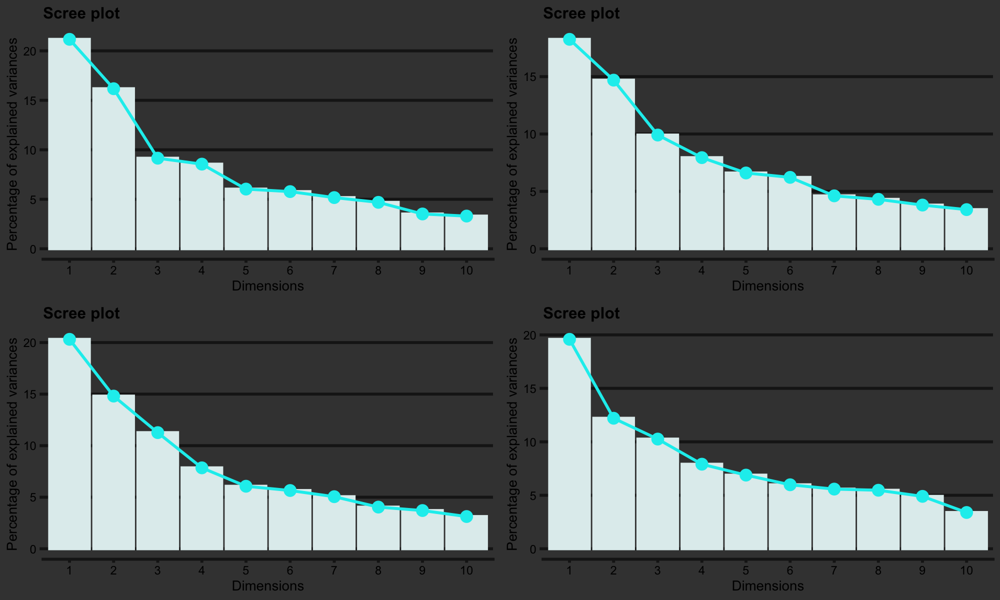

In [9]:
p1 = fviz_eig(bad_pca,linecolor = "cyan2",barcolor = "azure2",barfill = "azure2") + mythm
p2 = fviz_eig(iad_pca,linecolor = "cyan2",barcolor = "azure2",barfill = "azure2") + mythm
p3 = fviz_eig(mad_pca,linecolor = "cyan2",barcolor = "azure2",barfill = "azure2") + mythm
p4 = fviz_eig(mod_pca,linecolor = "cyan2",barcolor = "azure2",barfill = "azure2") + mythm
grid.arrange(p1,p2,p3,p4,nrow = 2)

Define groups to color the individual points by

In [10]:
mybgrps = as.factor(str_extract(row.names(bad1),"^\\w+(?=:)"))
myigrps = as.factor(str_extract(row.names(iad1),"^\\w+(?=:)"))
mymgrps = as.factor(str_extract(row.names(mad1),"^\\w+(?=:)"))
mygrps = as.factor(str_extract(row.names(mod1),"^\\w+(?=:)"))

Filter out some labels for readability

In [13]:
bavgs = avgs %>% dplyr::filter(str_detect(V1,"_[EML]?BA"))
iavgs = avgs %>% dplyr::filter(str_detect(V1,"_[EML]?IA"))
mavgs = avgs %>% dplyr::filter(str_detect(V1,"_[MV]A"))
smpld = as_tibble(import("../Genetics/G25/Data/CSV/Modern_Eurasia_sampled.csv"))
modavgs = modavgs %>% dplyr::filter(V1 %in% str_extract(smpld$V1,"^\\w+(?=:)"))

In [14]:
bavgs1 = bavgs %>% select(-V1)
row.names(bavgs1) = bavgs$V1
iavgs1 = iavgs %>% select(-V1)
row.names(iavgs1) = iavgs$V1
mavgs1 = mavgs %>% select(-V1)
row.names(mavgs1) = mavgs$V1
modavgs1 = modavgs %>% select(-V1)
row.names(modavgs1) = modavgs$V1

Warning message:
“Setting row names on a tibble is deprecated.”
Warning message:
“Setting row names on a tibble is deprecated.”
Warning message:
“Setting row names on a tibble is deprecated.”
Warning message:
“Setting row names on a tibble is deprecated.”


In [15]:
bavg.coord = predict(bad_pca,bavgs1)
row.names(bavg.coord) = row.names(bavgs1)
iavg.coord = predict(iad_pca,iavgs1)
row.names(iavg.coord) = row.names(iavgs1)
mavg.coord = predict(mad_pca,mavgs1)
row.names(mavg.coord) = row.names(mavgs1)
modavg.coord = predict(mod_pca,modavgs1)
row.names(modavg.coord) = row.names(modavgs1)

Create base PCA plot

In [16]:
myp1 = fviz_pca_ind(bad_pca,pointsize = 1,repel = TRUE,col.ind = as.numeric(mybgrps),alpha.ind = 0.5,geom = c("point"))
myp2 = fviz_pca_ind(iad_pca,pointsize = 1,repel = TRUE,col.ind = as.numeric(myigrps),alpha.ind = 0.5,geom = c("point"))
myp3 = fviz_pca_ind(mad_pca,pointsize = 1,repel = TRUE,col.ind = as.numeric(mymgrps),alpha.ind = 0.5,geom = c("point"))
myp4 = fviz_pca_ind(mod_pca,pointsize = 1,repel = TRUE,col.ind = as.numeric(mygrps),alpha.ind = 0.5,geom = c("point"))

Add population averages

In [17]:
myp1 = fviz_add(myp1,bavg.coord,color = "snow",labelsize = 1.5,alpha = 0.25,geom = c("text"),repel = TRUE,max.overlaps = 30)
myp2 = fviz_add(myp2,iavg.coord,color = "snow",labelsize = 1.5,alpha = 0.25,geom = c("text"),repel = TRUE,max.overlaps = 30)
myp3 = fviz_add(myp3,mavg.coord,color = "snow",labelsize = 1.5,alpha = 0.25,geom = c("text"),repel = TRUE,max.overlaps = 30)
myp4 = fviz_add(myp4,modavg.coord,color = "snow",labelsize = 1.5,alpha = 0.25,geom = c("text"),repel = TRUE,max.overlaps = 30)

Add individuals

In [18]:
ppl1 = ppl %>% select(-V1)
row.names(ppl1) = str_extract(as.character(ppl$V1),"^\\w+(?=:)")
ppl.coord.1 = predict(bad_pca,ppl1)
row.names(ppl.coord.1) = row.names(ppl1)
ppl.coord.2 = predict(iad_pca,ppl1)
row.names(ppl.coord.2) = row.names(ppl1)
ppl.coord.3 = predict(mad_pca,ppl1)
row.names(ppl.coord.3) = row.names(ppl1)
ppl.coord.4 = predict(mod_pca,ppl1)
row.names(ppl.coord.4) = row.names(ppl1)

Warning message:
“Setting row names on a tibble is deprecated.”


In [19]:
myp1 = fviz_add(myp1,ppl.coord.1,color = "orange",pointsize = 2,labelsize = 2)
myp2 = fviz_add(myp2,ppl.coord.2,color = "orange",pointsize = 2,labelsize = 2)
myp3 = fviz_add(myp3,ppl.coord.3,color = "orange",pointsize = 2,labelsize = 2)
myp4 = fviz_add(myp4,ppl.coord.4,color = "orange",pointsize = 2,labelsize = 2)

Set options

In [20]:
myp1 = myp1 + scale_color_viridis_c(option = "H") + guides(color = "none")
myp2 = myp2 + scale_color_viridis_c(option = "H") + guides(color = "none")
myp3 = myp3 + scale_color_viridis_c(option = "H") + guides(color = "none")
myp4 = myp4 + scale_color_viridis_c(option = "H") + guides(color = "none")

In [21]:
options(repr.plot.width = 12, repr.plot.height = 10, repr.plot.res = 400)

Warning message:
“ggrepel: 33 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


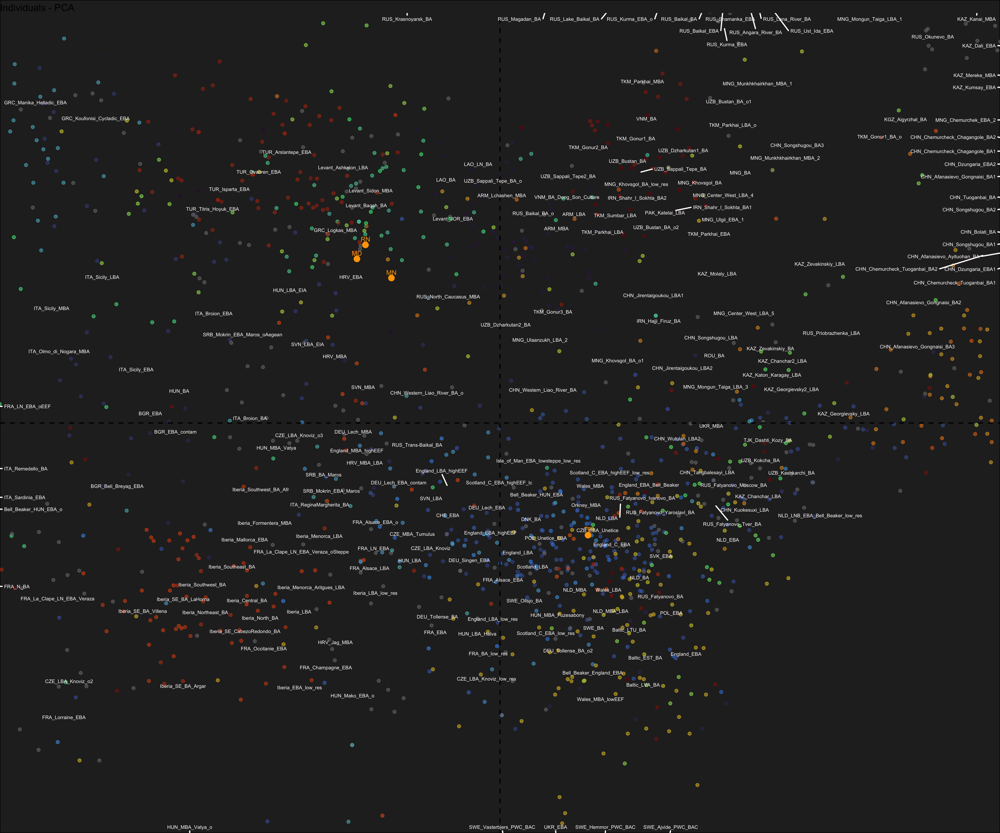

In [22]:
myp1 + coord_cartesian(xlim = c(-4,4),ylim = c(-3,3)) + theme_void(7) + theme(plot.background = element_rect(fill = "gray15"))

Warning message:
“ggrepel: 79 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


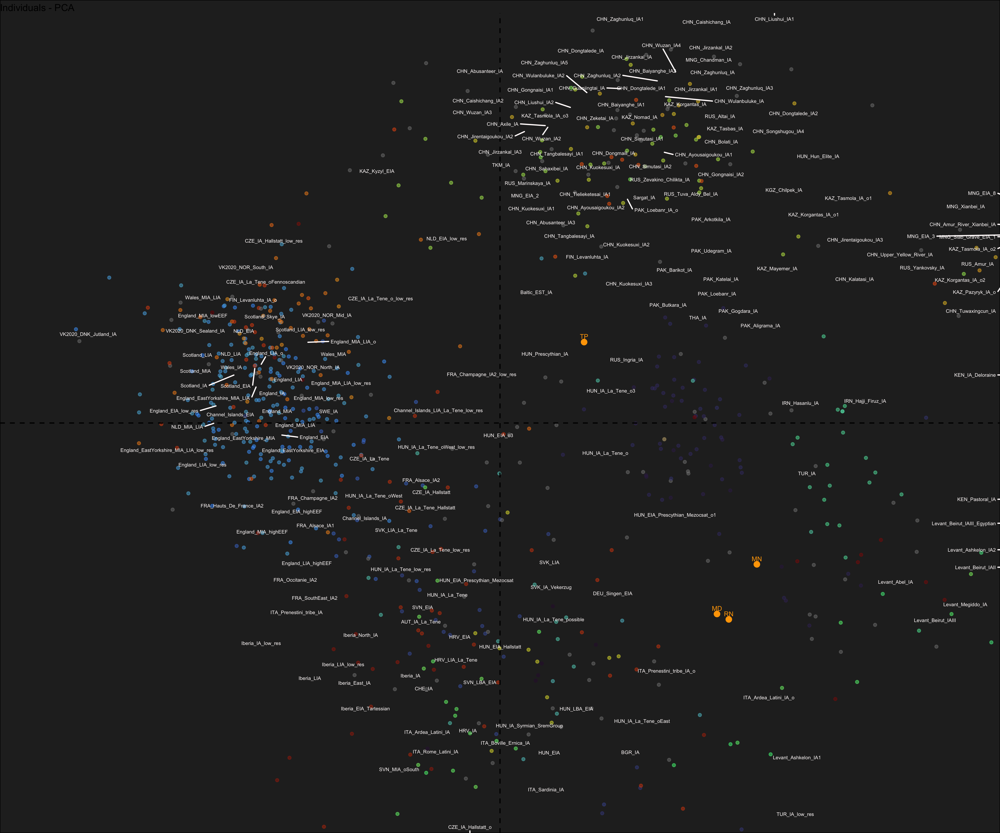

In [23]:
myp2 + coord_cartesian(xlim = c(-4,4),ylim = c(-4,4)) + theme_void(7) + theme(plot.background = element_rect(fill = "gray15"))

Warning message:
“ggrepel: 21 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


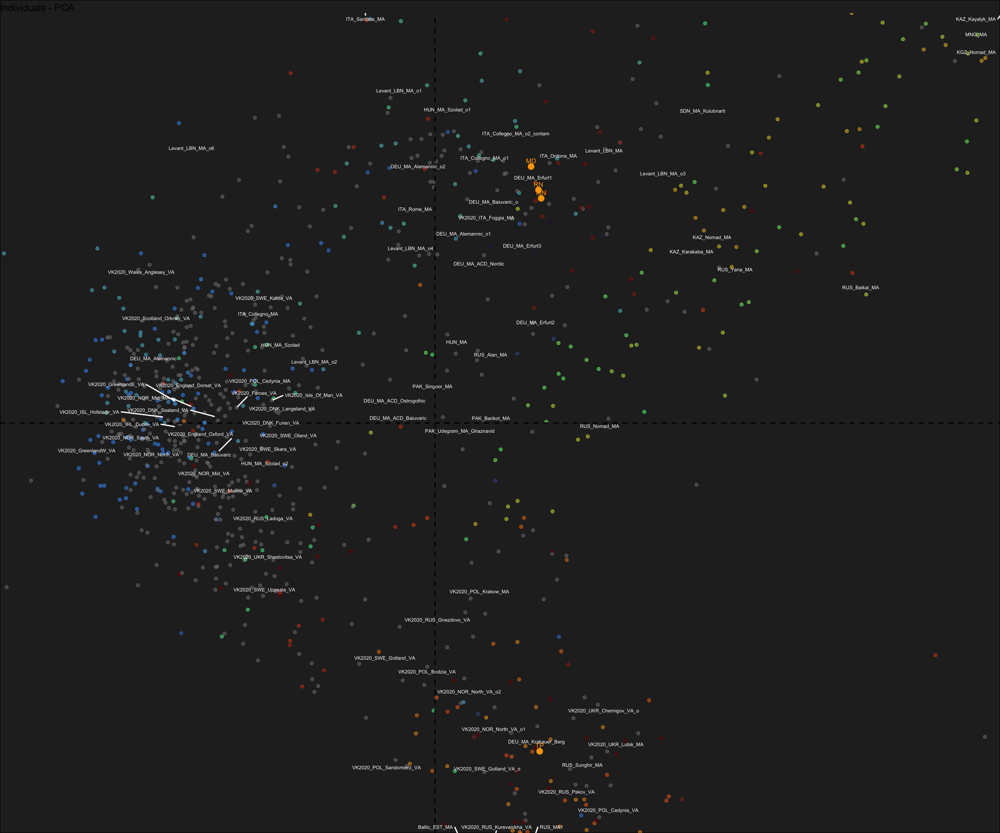

In [24]:
myp3 + coord_cartesian(xlim = c(-3,4),ylim = c(-3,3)) + theme_void(7) + theme(plot.background = element_rect(fill = "gray15"))

Warning message:
“ggrepel: 144 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


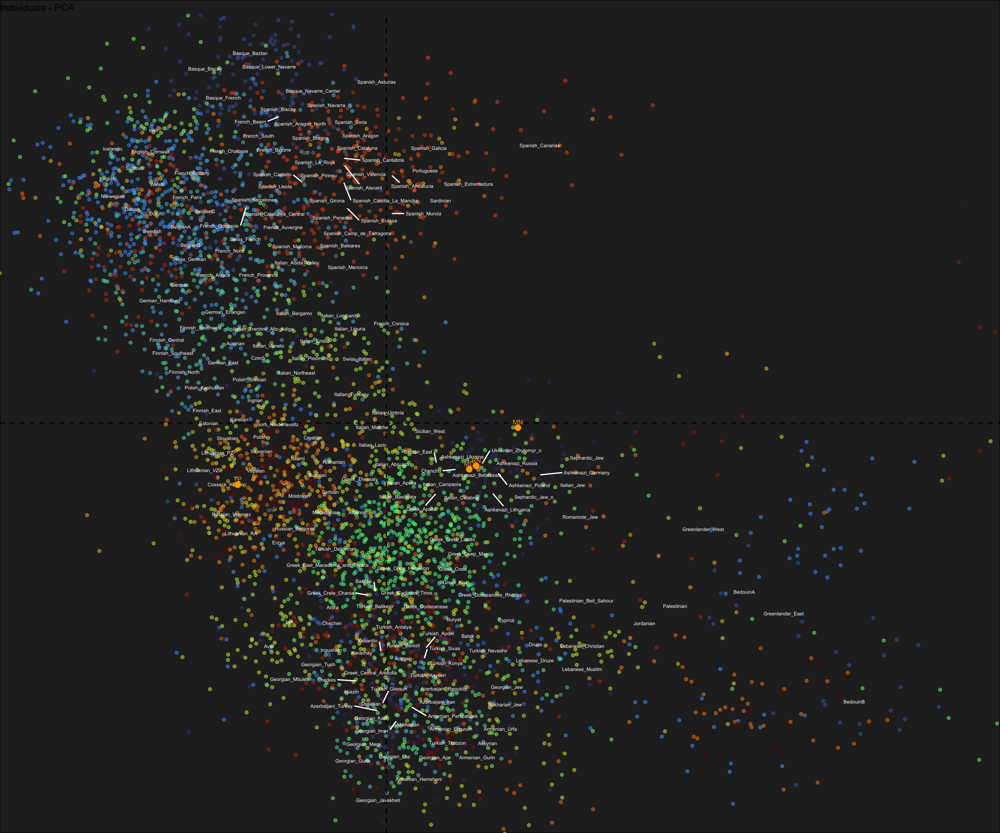

In [38]:
myp4 + coord_cartesian(xlim = c(-3,5),ylim = c(-3,3)) + theme_void(7) + theme(plot.background = element_rect(fill = "gray15"))

Add k-means clusters — use only the first 3 dimensions for clarity (otherwise, the clusters overlap like crazy...)

In [50]:
kmdt1 = as_tibble(bad_pca$x) %>% select(matches("C[12]$"))
kmdt2 = as_tibble(iad_pca$x) %>% select(matches("C[12]$"))
kmdt3 = as_tibble(mad_pca$x) %>% select(matches("C[12]$"))
kmdt4 = as_tibble(mod_pca$x) %>% select(matches("C[12]$"))

In [51]:
options(repr.plot.width = 6, repr.plot.height = 3.5, repr.plot.res = 400)

Warning message:
“did not converge in 10 iterations”
Warning message:
“did not converge in 10 iterations”
Warning message:
“did not converge in 10 iterations”
Warning message:
“did not converge in 10 iterations”
Warning message:
“did not converge in 10 iterations”


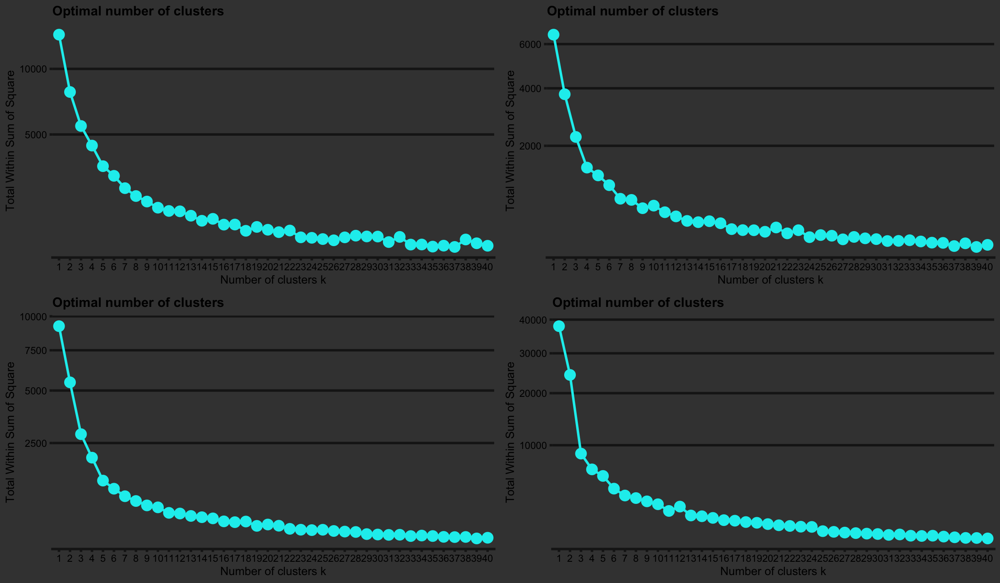

In [52]:
p1 = fviz_nbclust(kmdt1,kmeans,method = 'wss',k.max = 40,linecolor = "cyan2") + scale_y_sqrt() + mythm
p2 = fviz_nbclust(kmdt2,kmeans,method = 'wss',k.max = 40,linecolor = "cyan2") + scale_y_sqrt() + mythm
p3 = fviz_nbclust(kmdt3,kmeans,method = 'wss',k.max = 40,linecolor = "cyan2") + scale_y_sqrt() + mythm
p4 = fviz_nbclust(kmdt4,kmeans,method = 'wss',k.max = 40,linecolor = "cyan2") + scale_y_sqrt() + mythm
grid.arrange(p1,p2,p3,p4,nrow = 2)

In [124]:
mykm1 = kmeans(kmdt1,centers = 18,nstart = 50)
mykm2 = kmeans(kmdt2,centers = 18,nstart = 50)
mykm3 = kmeans(kmdt3,centers = 18,nstart = 50)
mykm4 = kmeans(kmdt4,centers = 18,nstart = 50)

Warning message:
“did not converge in 10 iterations”


In [119]:
options(repr.plot.width = 16, repr.plot.height = 14, repr.plot.res = 400)

Create base plots with clusters

In [125]:
myp1.1 = fviz_cluster(mykm1,data = kmdt1,labelsize = 2,geom = c("text"),alpha = 0.5) + scale_fill_viridis_d(option = "H")
myp2.1 = fviz_cluster(mykm2,data = kmdt2,labelsize = 2,geom = c("text"),alpha = 0.5) + scale_fill_viridis_d(option = "H")
myp3.1 = fviz_cluster(mykm3,data = kmdt3,labelsize = 2,geom = c("text"),alpha = 0.5) + scale_fill_viridis_d(option = "H")
myp4.1 = fviz_cluster(mykm4,data = kmdt4,labelsize = 2,geom = c("text"),alpha = 0.5) + scale_fill_viridis_d(option = "H")

Add population averages as labels

In [126]:
myp1.1 = fviz_add(myp1.1,bavg.coord,color = "snow",labelsize = 2,alpha = 0.5,geom = c("text"),repel = TRUE,max.overlaps = 30)
myp2.1 = fviz_add(myp2.1,iavg.coord,color = "snow",labelsize = 2,alpha = 0.5,geom = c("text"),repel = TRUE,max.overlaps = 30)
myp3.1 = fviz_add(myp3.1,mavg.coord,color = "snow",labelsize = 2,alpha = 0.5,geom = c("text"),repel = TRUE,max.overlaps = 30)
myp4.1 = fviz_add(myp4.1,modavg.coord,color = "snow",labelsize = 2,alpha = 0.5,geom = c("text"),repel = TRUE,max.overlaps = 30)

Add individuals

In [127]:
myp1.1 = fviz_add(myp1.1,ppl.coord.1,color = "orange",labelsize = 2.5)
myp2.1 = fviz_add(myp2.1,ppl.coord.2,color = "orange",labelsize = 2.5)
myp3.1 = fviz_add(myp3.1,ppl.coord.3,color = "orange",labelsize = 2.5)
myp4.1 = fviz_add(myp4.1,ppl.coord.4,color = "orange",labelsize = 2.5)

Add options and plot

Warning message:
“ggrepel: 26 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 63 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


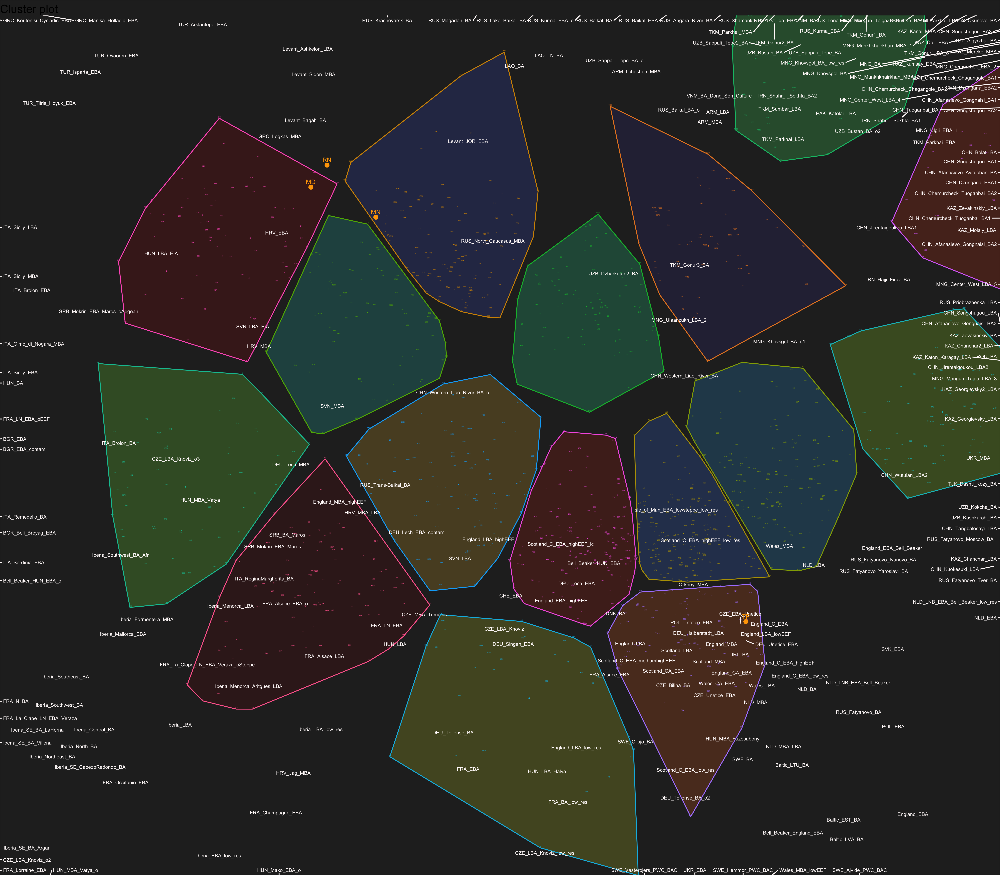

Warning message:
“ggrepel: 21 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


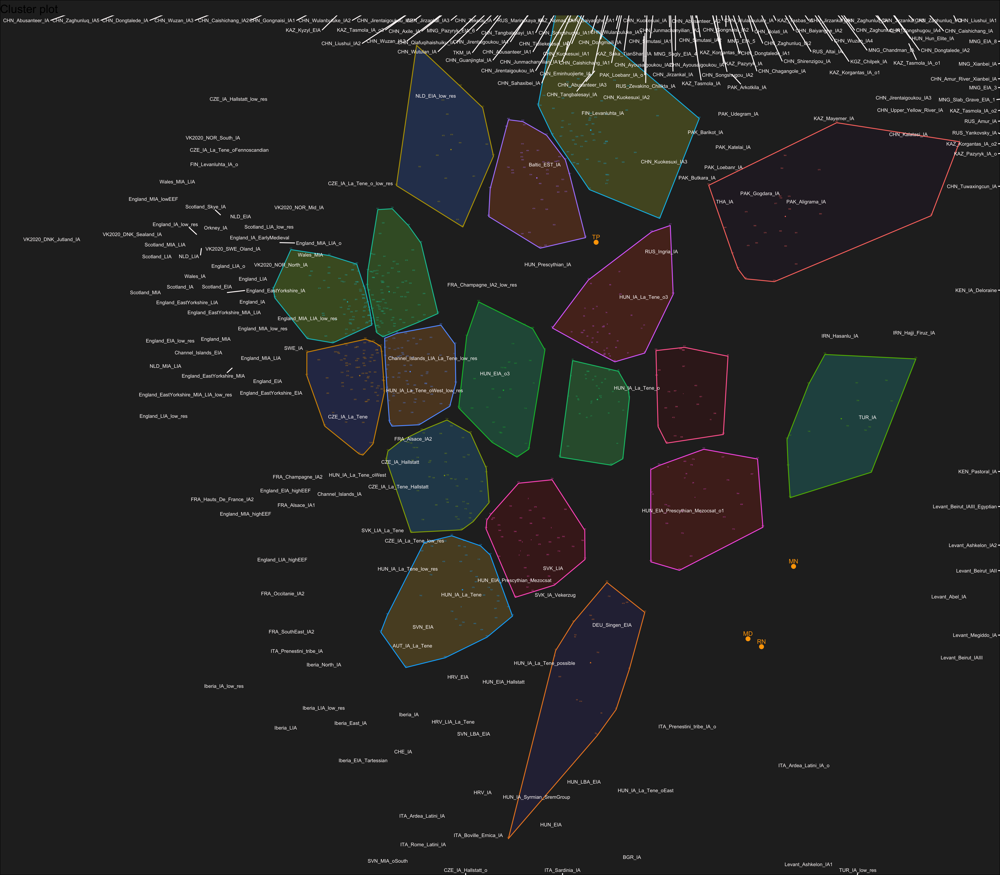

Warning message:
“ggrepel: 148 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


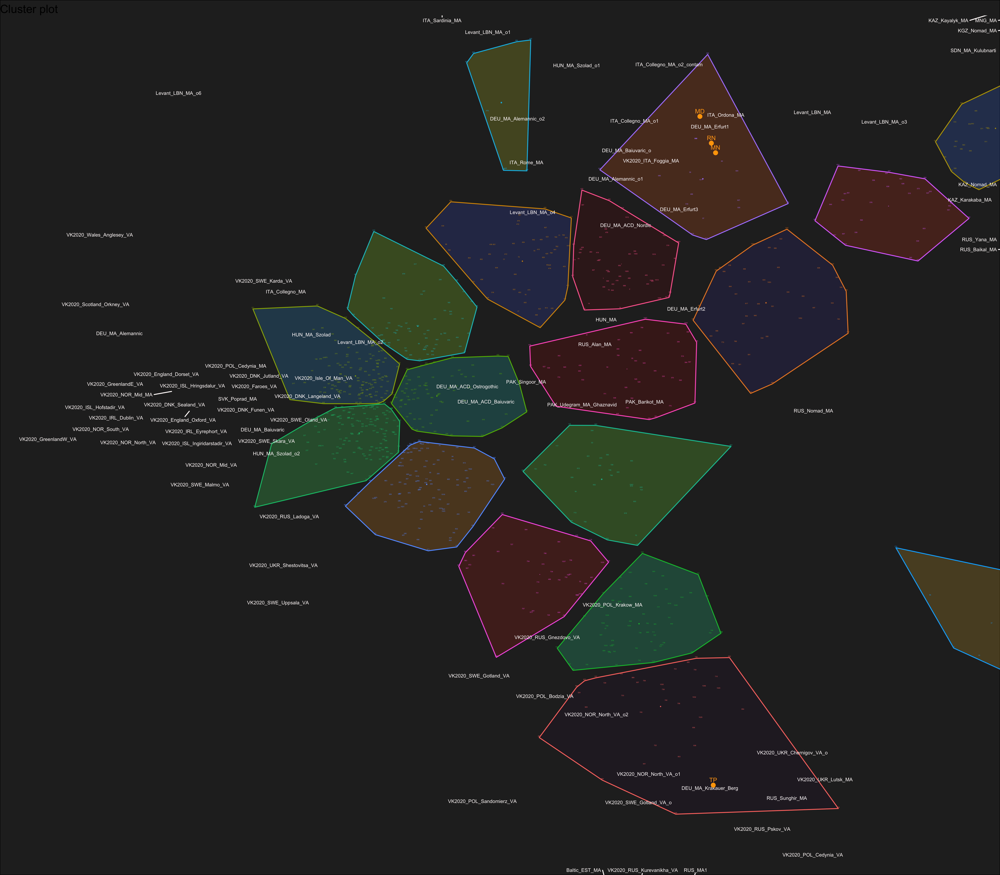

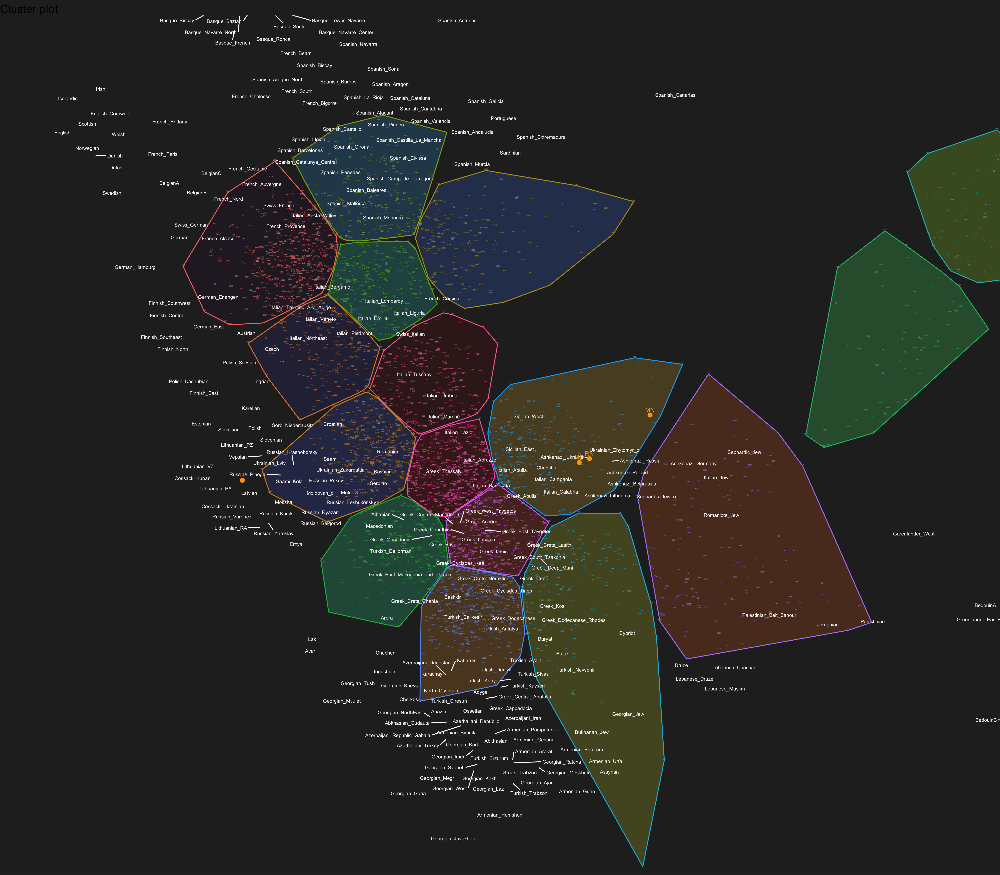

In [128]:
myp1.1 + guides(color = "none",fill = "none",shape = "none") + theme_void() + theme(plot.background = element_rect(fill = "gray15")) + coord_cartesian(xlim = c(-2.5,1.75),ylim = c(-2,2))
myp2.1 + guides(color = "none",fill = "none",shape = "none") + theme_void() + theme(plot.background = element_rect(fill = "gray15")) + coord_cartesian(xlim = c(-3.5,3.5),ylim = c(-3.5,2.25))
myp3.1 + guides(color = "none",fill = "none",shape = "none") + theme_void() + theme(plot.background = element_rect(fill = "gray15")) + coord_cartesian(xlim = c(-2.5,2),ylim = c(-3,2.5))
myp4.1 + guides(color = "none",fill = "none",shape = "none") + theme_void() + theme(plot.background = element_rect(fill = "gray15")) + coord_cartesian(xlim = c(-2.5,3),ylim = c(-3,2.5))

Find the closest samples to each individual

Create combined data frames

In [33]:
nndt1 = bind_rows(bad1,ppl1)
nndt2 = bind_rows(iad1,ppl1)
nndt3 = bind_rows(mad1,ppl1)
nndt4 = bind_rows(mod1,ppl1)

Calculate k-nearest-neighbors

In [34]:
mynn1 = kNN(nndt1,k = 8)
mynn2 = kNN(nndt2,k = 8)
mynn3 = kNN(nndt3,k = 8)
mynn4 = kNN(nndt4,k = 8)

Pull out the results and reformat

In [35]:
myres1 = mynn1$id[nrow(bad)+1:nrow(ppl1),]
myres2 = mynn2$id[nrow(iad)+1:nrow(ppl1),]
myres3 = mynn3$id[nrow(mad)+1:nrow(ppl1),]
myres4 = mynn4$id[nrow(mod)+1:nrow(ppl1),]

In [36]:
myres1 = myres1 %>% as_tibble() %>% mutate(person = row.names(myres1),.before = 1)
myres2 = myres2 %>% as_tibble() %>% mutate(person = row.names(myres2),.before = 1)
myres3 = myres3 %>% as_tibble() %>% mutate(person = row.names(myres3),.before = 1)
myres4 = myres4 %>% as_tibble() %>% mutate(person = row.names(myres4),.before = 1)

In [37]:
myres1 = myres1 %>% pivot_longer(cols = matches("^\\d$"),names_to = "var",values_to = "val")
myres2 = myres2 %>% pivot_longer(cols = matches("^\\d$"),names_to = "var",values_to = "val")
myres3 = myres3 %>% pivot_longer(cols = matches("^\\d$"),names_to = "var",values_to = "val")
myres4 = myres4 %>% pivot_longer(cols = matches("^\\d$"),names_to = "var",values_to = "val")

In [38]:
myres1 = myres1 %>% bind_cols(bad[myres1$val,1])
myres2 = myres2 %>% bind_cols(iad[myres2$val,1])
myres3 = myres3 %>% bind_cols(mad[myres3$val,1])
myres4 = myres4 %>% bind_cols(mod[myres4$val,1])

In [39]:
myres1 = myres1 %>% mutate(name = str_extract(sample,"^.+(?=:)"),sample = str_extract(sample,"(?<=:).+$"))
myres2 = myres2 %>% mutate(name = str_extract(sample,"^.+(?=:)"),sample = str_extract(sample,"(?<=:).+$"))
myres3 = myres3 %>% mutate(name = str_extract(sample,"^.+(?=:)"),sample = str_extract(sample,"(?<=:).+$"))
myres4 = myres4 %>% mutate(name = str_extract(sample,"^.+(?=:)"),sample = str_extract(sample,"(?<=:).+$"))

In [40]:
options(repr.plot.width = 6, repr.plot.height = 3, repr.plot.res = 400)

Warning message:
“The `facets` argument of `facet_grid()` is deprecated as of ggplot2 2.2.0.
ℹ Please use the `rows` argument instead.”
Coordinate system already present. Adding new coordinate system, which will
replace the existing one.
Coordinate system already present. Adding new coordinate system, which will
replace the existing one.


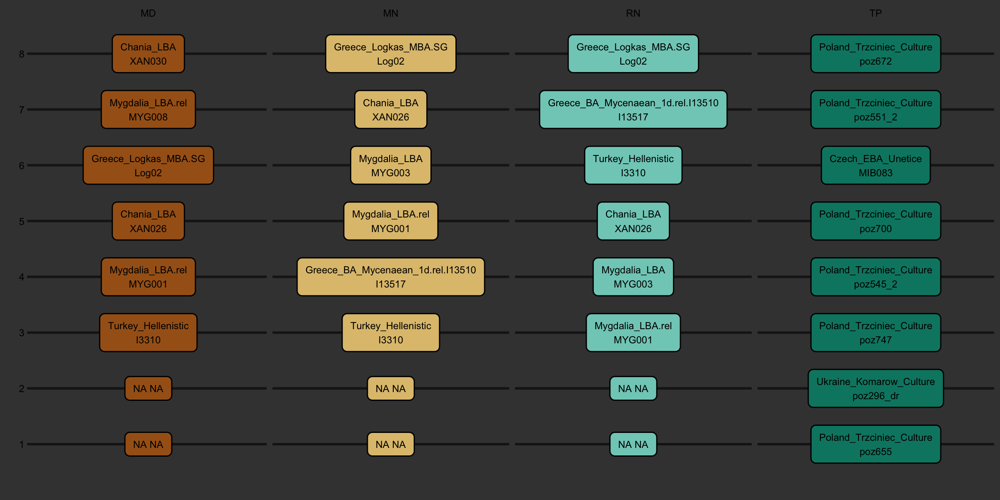

Coordinate system already present. Adding new coordinate system, which will
replace the existing one.


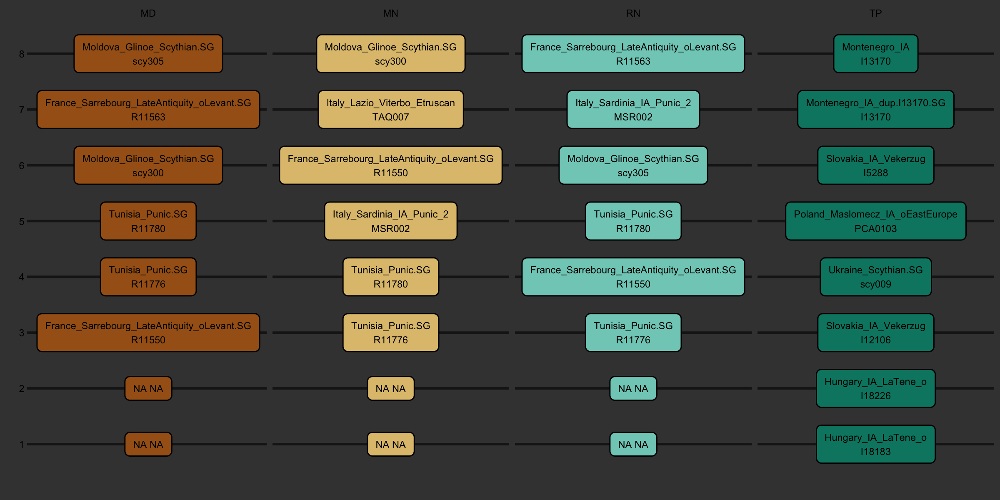

Coordinate system already present. Adding new coordinate system, which will
replace the existing one.


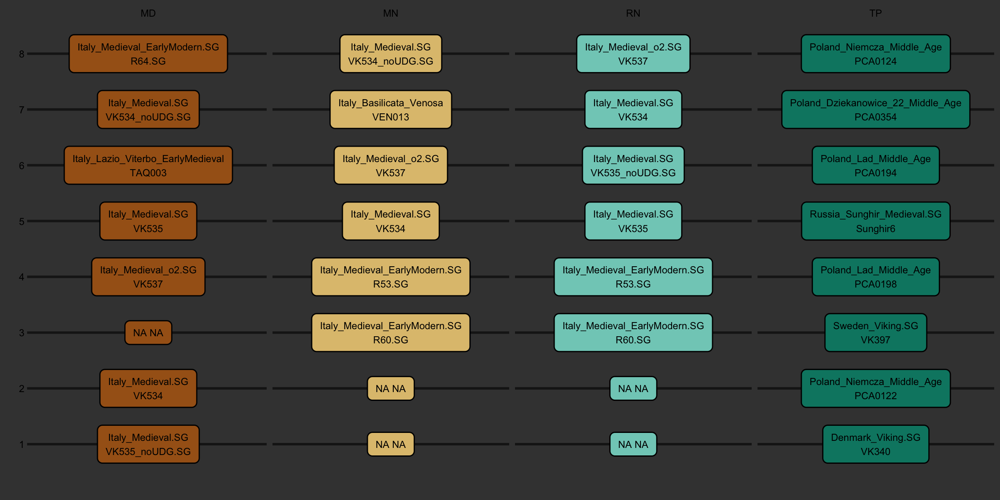

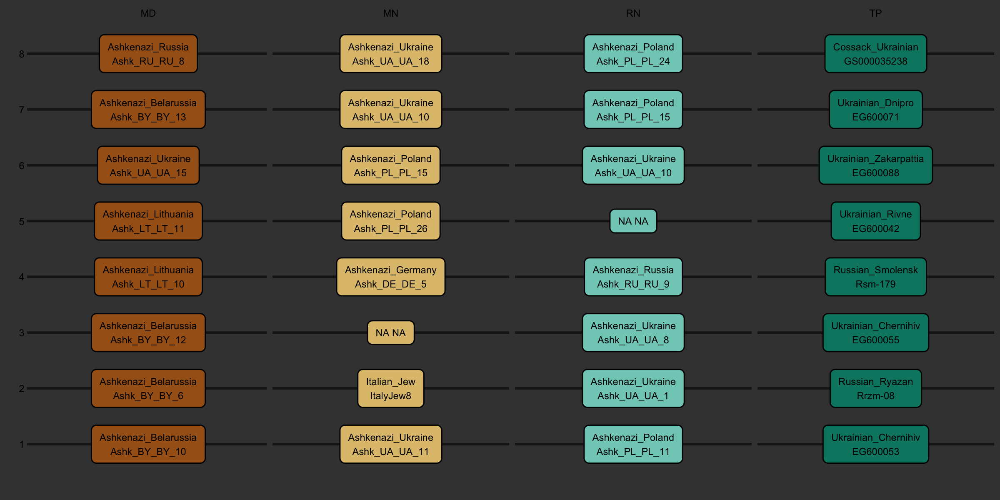

In [41]:
ggplot(myres1,aes(var,I(1))) + geom_label(stat = "identity",aes(label = str_wrap(paste(name,sample),10),fill = person),size = 1.5) + 
    facet_grid(facets = ~ person) + coord_cartesian(ylim = c(3,8)) + coord_flip() + guides(fill = "none") + scale_fill_brewer(type = "div") + mythm +
    theme(axis.text.x = element_blank(),axis.line.x = element_blank(),axis.ticks.x = element_blank()) + xlab("") + ylab("")
ggplot(myres2,aes(var,I(1))) + geom_label(stat = "identity",aes(label = str_wrap(paste(name,sample),10),fill = person),size = 1.5) + 
    facet_grid(facets = ~ person) + coord_cartesian(ylim = c(3,8)) + coord_flip() + guides(fill = "none") + scale_fill_brewer(type = "div") + mythm +
    theme(axis.text.x = element_blank(),axis.line.x = element_blank(),axis.ticks.x = element_blank()) + xlab("") + ylab("")
ggplot(myres3,aes(var,I(1))) + geom_label(stat = "identity",aes(label = str_wrap(paste(name,sample),10),fill = person),size = 1.5) + 
    facet_grid(facets = ~ person) + coord_cartesian(ylim = c(3,8)) + coord_flip() + guides(fill = "none") + scale_fill_brewer(type = "div") + mythm +
    theme(axis.text.x = element_blank(),axis.line.x = element_blank(),axis.ticks.x = element_blank()) + xlab("") + ylab("")
ggplot(myres4,aes(var,I(1))) + geom_label(stat = "identity",aes(label = str_wrap(paste(name,sample),10),fill = person),size = 1.5) + 
    facet_grid(facets = ~ person) + coord_cartesian(ylim = c(3,8)) + coord_flip() + guides(fill = "none") + scale_fill_brewer(type = "div") + mythm +
    theme(axis.text.x = element_blank(),axis.line.x = element_blank(),axis.ticks.x = element_blank()) + xlab("") + ylab("")

Do this for population averages as well

In [134]:
ls()

[1] "avgs"         "bad"          "bad_pca"      "bad1"         "bavg.coord"  
 [6] "bavgs"        "bavgs1"       "iad"          "iad_pca"      "iad1"        
[11] "iavg.coord"   "iavgs"        "iavgs1"       "kmdt1"        "kmdt2"       
[16] "kmdt3"        "kmdt4"        "mad"          "mad_pca"      "mad1"        
[21] "mavg.coord"   "mavgs"        "mavgs1"       "mod"          "mod_pca"     
[26] "mod1"         "modavg.coord" "modavgs"      "modavgs1"     "mybgrps"     
[31] "mygrps"       "myigrps"      "mykm1"        "mykm2"        "mykm3"       
[36] "mykm4"        "mymgrps"      "mynn1"        "mynn2"        "mynn3"       
[41] "mynn4"        "myp1"         "myp1.1"       "myp2"         "myp2.1"      
[46] "myp3"         "myp3.1"       "myp4"         "myp4.1"       "myres1"      
[51] "myres2"       "myres3"       "myres4"       "mythm"        "nndt1"       
[56] "nndt2"        "nndt3"        "nndt4"        "p1"           "p2"          
[61] "p3"           "p4"           "ppl"          "ppl.coord.1"  "ppl.coord.2" 
[66] "ppl.coord.3"  "ppl.coord.4"  "ppl1"         "smpld"

In [178]:
myavgs = bind_rows(bavgs1,iavgs1,mavgs1,modavgs1)
mynn = kNN(myavgs,k = nrow(myavgs)-1)
mynn

k-nearest neighbors for 838 objects (k=837).
Available fields: dist, id, k, sort

In [179]:
mynn = rownames_to_column(as.data.frame(mynn$id)) %>% as_tibble() %>% mutate(`0` = row_number(),.after = rowname)

In [180]:
mynn %>% sample_n(10)

rowname,0,1,2,3,4,5,6,7,8,⋯,828,829,830,831,832,833,834,835,836,837
<chr>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,⋯,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
Greek_West_Taygetos,698,692,667,687,669,686,694,670,691,⋯,34,302,421,253,189,445,441,179,35,407
Levant_Abel_IA,410,142,144,414,413,141,747,502,412,⋯,302,156,421,253,189,445,441,407,179,35
DEU_Tollense_BA_o2,51,369,733,737,738,736,735,734,729,⋯,140,253,34,302,189,445,441,179,35,407
England_EastYorkshire_LIA,327,329,61,341,334,337,196,704,65,⋯,421,34,302,253,189,445,441,179,35,407
CHN_Tuoganbai_BA,33,21,14,23,22,16,18,28,24,⋯,34,189,179,445,302,441,140,35,408,407
BedouinA,605,746,724,415,732,144,412,502,731,⋯,34,156,302,421,253,189,445,441,179,35
Armenian_Hemsheni,572,828,654,697,651,656,649,821,570,⋯,156,302,421,253,189,445,441,179,35,407
CHN_Dongtalede_IA2,267,394,500,155,498,397,313,282,259,⋯,121,73,82,78,9,122,76,518,408,407
HUN_IA_La_Tene,366,199,198,458,363,635,455,242,457,⋯,34,302,421,253,189,445,441,179,35,407


In [183]:
mynames = mynn %>% select(rowname) %>% mutate(val = row_number())

In [187]:
mynn = mynn %>% pivot_longer(cols = matches("^\\d"),names_to = "rank",values_to = "val") %>% inner_join(mynames,by = "val") %>% select(c(1,2,4))

In [188]:
colnames(mynn) = c("target","distance","population")

In [193]:
mynn = mynn %>% dplyr::filter(distance %in% 1:10)

In [198]:
write_csv(mynn,"../Genetics/G25/Data/CSV/top_10_dist_all.csv")

In [197]:
print(mynn %>% dplyr::filter(str_detect(target,"^Ukrain")) %>% as.data.frame())

                  target distance            population
1    Ukrainian_Chernihiv        1       Ukrainian_Rivne
2    Ukrainian_Chernihiv        2      Russian_Belgorod
3    Ukrainian_Chernihiv        3      Ukrainian_Dnipro
4    Ukrainian_Chernihiv        4        Ukrainian_Sumy
5    Ukrainian_Chernihiv        5    Ukrainian_Zhytomyr
6    Ukrainian_Chernihiv        6       Russian_Voronez
7    Ukrainian_Chernihiv        7      Russian_Smolensk
8    Ukrainian_Chernihiv        8          Russian_Orel
9    Ukrainian_Chernihiv        9         Russian_Kursk
10   Ukrainian_Chernihiv       10            Belarusian
11      Ukrainian_Dnipro        1         Russian_Kursk
12      Ukrainian_Dnipro        2          Russian_Orel
13      Ukrainian_Dnipro        3   Ukrainian_Chernihiv
14      Ukrainian_Dnipro        4       Ukrainian_Rivne
15      Ukrainian_Dnipro        5       Russian_Voronez
16      Ukrainian_Dnipro        6      Russian_Belgorod
17      Ukrainian_Dnipro        7        Russian